In [1]:
from tensorflow.keras.preprocessing import image
from tensorflow.keras.layers import Conv2D, Conv3D, UpSampling2D, InputLayer, Conv2DTranspose, Input, Reshape, concatenate
from tensorflow.keras.layers import Activation, Dense, Dropout, Flatten,RepeatVector
from tensorflow.keras.layers import BatchNormalization
from tensorflow.keras.models import Sequential, Model
from tensorflow.keras.preprocessing.image import ImageDataGenerator, array_to_img, img_to_array, load_img
from tensorflow.keras.applications.inception_resnet_v2 import InceptionResNetV2
from tensorflow.keras.applications.inception_resnet_v2 import preprocess_input
from skimage.color import rgb2lab, lab2rgb, rgb2gray, gray2rgb
from tensorflow.keras.callbacks import ModelCheckpoint, EarlyStopping, ReduceLROnPlateau
from skimage.transform import resize
import matplotlib.pyplot as plt
import numpy as np
import os
import random
from PIL import Image, ImageFile
import tensorflow as tf
from tensorflow import keras
from tensorflow.keras import layers
from skimage.metrics import mean_squared_error
import math

# Preparing Images For Model Training 

In [2]:
trainpath = 'D:\\fyp\\data_l_dis_lessblu\\'
testpath = 'D:\\fyp\\val\\'
testnewpath = 'D:\\fyp\\testirdraw\\' 
trainpath2 = 'D:\\fyp\\archive\\'
testnew = os.listdir(testnewpath)
batch_size=1
img_size = 256
train_datagen = ImageDataGenerator(rescale=1./255)
train = train_datagen.flow_from_directory(trainpath,batch_size=1,target_size=(img_size,img_size),class_mode=None)
train2 = train_datagen.flow_from_directory(trainpath2,batch_size=1,target_size=(img_size,img_size),class_mode=None)

Found 795 images belonging to 2 classes.


In [3]:
X =[]
Y =[]
for i in range(len(train)):
    for img in train[0]:
        lab = rgb2lab(img)
        X.append(lab[:,:,0])
        Y.append(lab[:,:,1:]/ 128) 

k=0
for i in range(len(train2)):
    for img in train2[0]:
        if k%5==0:
            lab = rgb2lab(img)
            X.append(lab[:,:,0])
            Y.append(lab[:,:,1:]/ 128) 
        k=k+1
X = np.array(X)
Y = np.array(Y)
X = X.reshape(X.shape+(1,))
print(X.shape)
print(Y.shape)

Found 4319 images belonging to 1 classes.
(1659, 256, 256, 1)
(1659, 256, 256, 2)


# Defining Unet Generator

In [4]:
import segmentation_models
segmentation_models.set_framework('tf.keras')
OUTPUT_CHANNELS = 2

Using TensorFlow backend.


Segmentation Models: using `keras` framework.


In [5]:
def Generator():
    unet = segmentation_models.Unet('resnet18', encoder_weights='imagenet', classes=OUTPUT_CHANNELS, activation='tanh', input_shape=(img_size, img_size, 3), decoder_use_batchnorm=False)
    inp = layers.Input(shape=[img_size, img_size, 1], name='input')
    x = layers.Concatenate()([inp, inp, inp])
    x = unet(x)
    model = tf.keras.Model(inputs=inp, outputs=x)
    return model

generator = Generator()

In [6]:
generator.summary()

Model: "model_2"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input (InputLayer)              [(None, 256, 256, 1) 0                                            
__________________________________________________________________________________________________
concatenate (Concatenate)       (None, 256, 256, 3)  0           input[0][0]                      
                                                                 input[0][0]                      
                                                                 input[0][0]                      
__________________________________________________________________________________________________
model_1 (Functional)            (None, 256, 256, 2)  14337739    concatenate[0][0]                
Total params: 14,337,739
Trainable params: 14,329,797
Non-trainable params: 7,942
__________

In [8]:
loss_object = tf.keras.losses.MeanAbsoluteError(reduction=tf.keras.losses.Reduction.SUM_OVER_BATCH_SIZE)
generator.compile(optimizer=tf.keras.optimizers.Adam(0.0001), loss='mae')

In [9]:
generator.fit(X,Y,epochs=20,batch_size=8,validation_split=0.2)

Epoch 1/20
166/166 [==============================] - 59s 283ms/step - loss: 0.0623 - val_loss: 0.0768
Epoch 2/20
166/166 [==============================] - 42s 254ms/step - loss: 0.0320 - val_loss: 0.0543
Epoch 3/20
166/166 [==============================] - 42s 253ms/step - loss: 0.0264 - val_loss: 0.0311
Epoch 4/20
166/166 [==============================] - 42s 253ms/step - loss: 0.0233 - val_loss: 0.0247
Epoch 5/20
166/166 [==============================] - 44s 263ms/step - loss: 0.0218 - val_loss: 0.0228
Epoch 6/20
166/166 [==============================] - 44s 265ms/step - loss: 0.0207 - val_loss: 0.0213
Epoch 7/20
166/166 [==============================] - 44s 265ms/step - loss: 0.0196 - val_loss: 0.0207
Epoch 8/20
166/166 [==============================] - 44s 266ms/step - loss: 0.0190 - val_loss: 0.0198
Epoch 9/20
166/166 [==============================] - 45s 271ms/step - loss: 0.0185 - val_loss: 0.0198
Epoch 10/20
166/166 [==============================] - 45s 271ms/step - l

In [7]:
def pred(path,modelg):
    fig, axis = plt.subplots(1,3,figsize=(15,5))
    test_imgs = []
    axis[2].imshow(load_img(testpath + path))         #showing original image
    axis[2].title.set_text("original image")
    img = img_to_array(load_img(testpath + path))
    img = resize(img ,(img_size,img_size))
    test_imgs.append(img)
    test_imgs = np.array(test_imgs, dtype=float)
    test_img = rgb2lab(1.0/255*test_imgs)[:,:,:,0]
    test_img = test_img.reshape(test_img.shape+(1,))
    axis[0].imshow(test_img[0],cmap='gray')           #showing monochrome image (input)
    axis[0].title.set_text("Monochrome image")
    output = modelg(test_img,training=False)
    output = output * 128
    for i in range(len(output)):
        result = np.zeros((img_size,img_size, 3))
        result[:,:,0] = test_img[i][:,:,0]
        result[:,:,1:] = output[i]
    axis[1].imshow(lab2rgb(result))                   #showing predicted image (output)
    axis[1].title.set_text("predicted image")    
    plt.show()

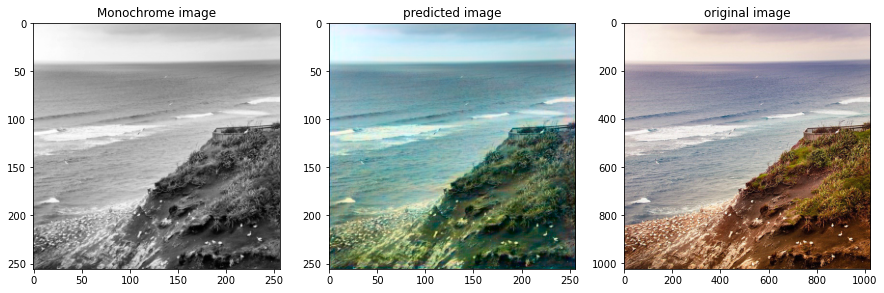

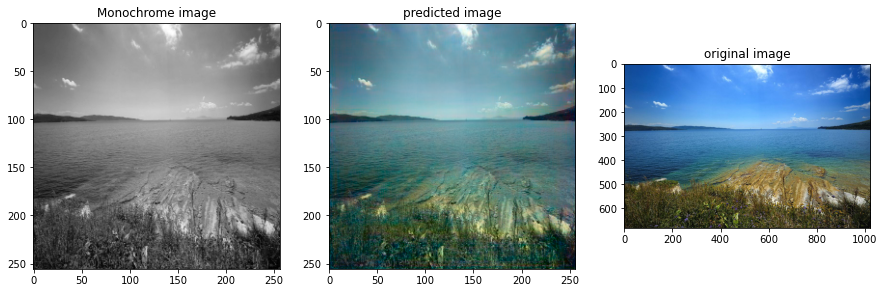

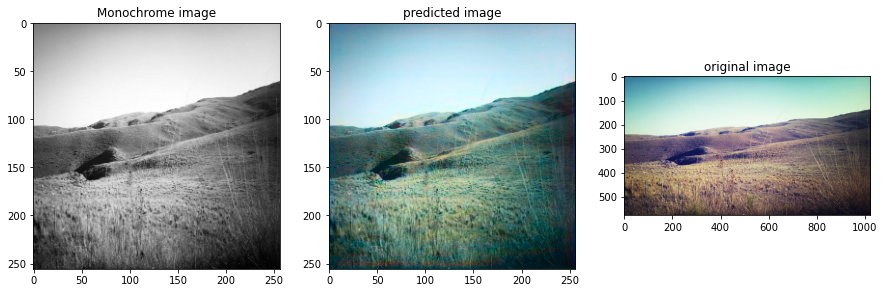

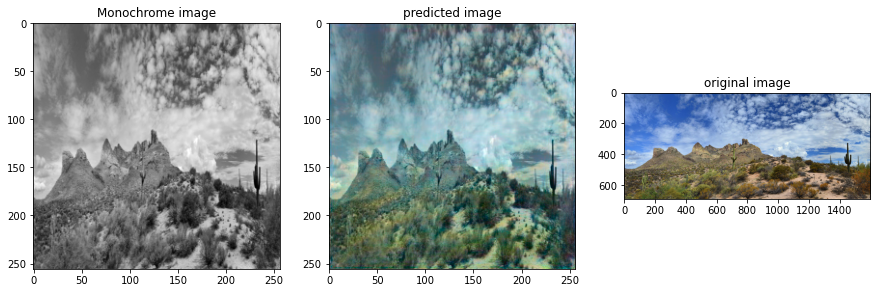

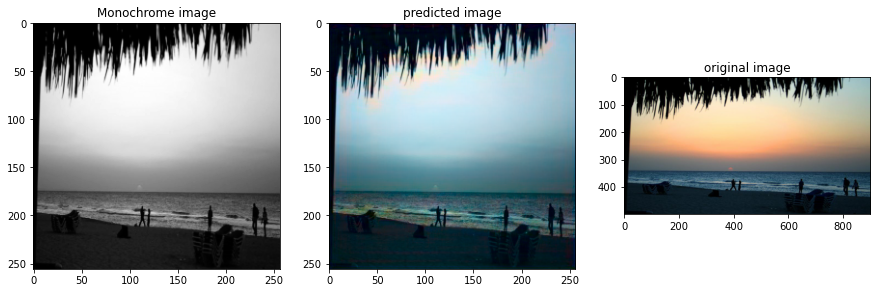

...

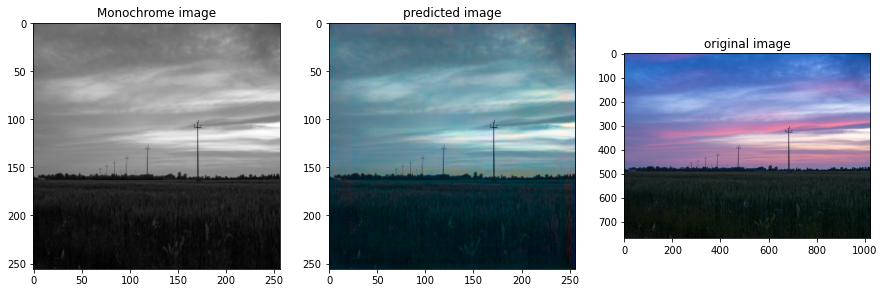

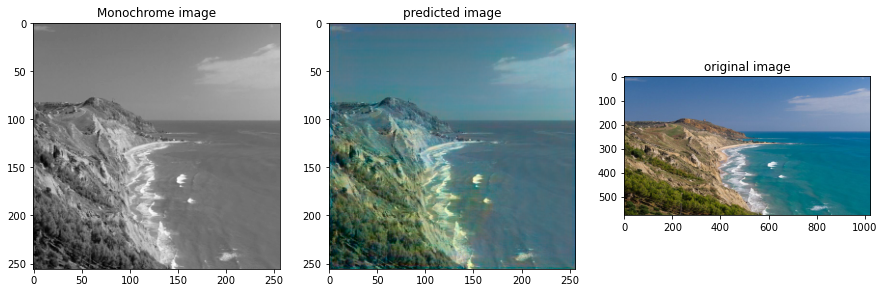

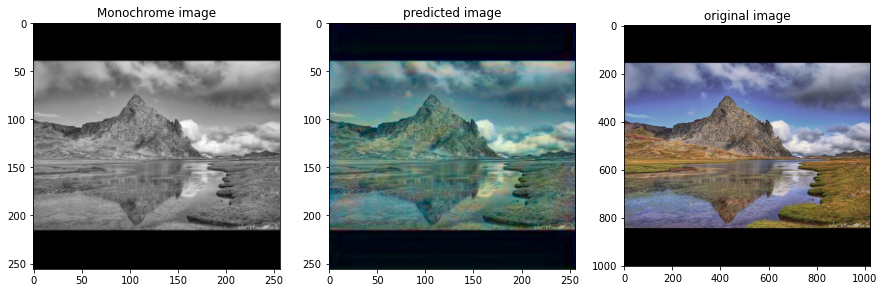

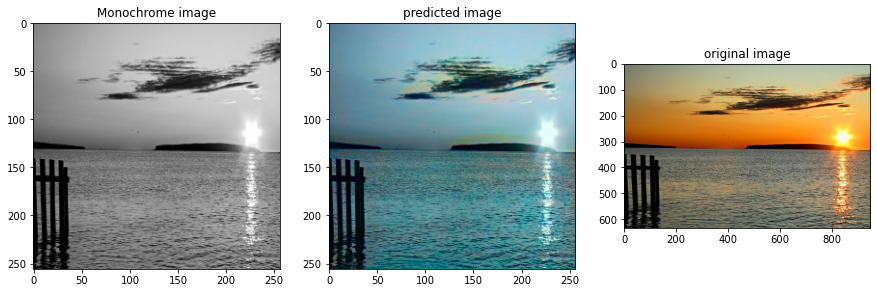

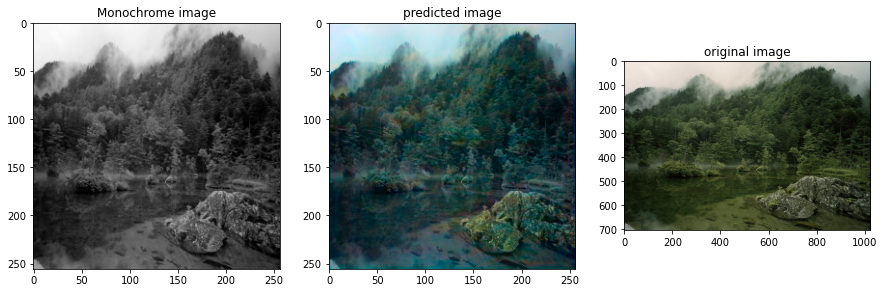

In [10]:
test = os.listdir(testpath)
for name in test:
    pred(name,generator)

In [11]:
generator.save("gen_newfull2.h5")

C:\Users\Chethan\anaconda3\lib\site-packages\tensorflow\python\keras\utils\generic_utils.py:494: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  warnings.warn('Custom mask layers require a config and must override '


In [28]:
generator=tf.keras.models.load_model('gen_new2.h5')

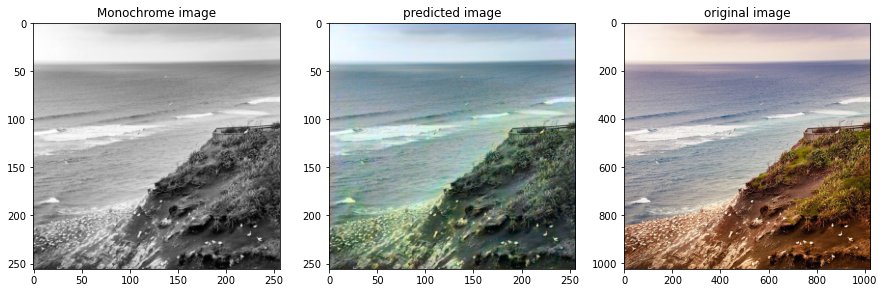

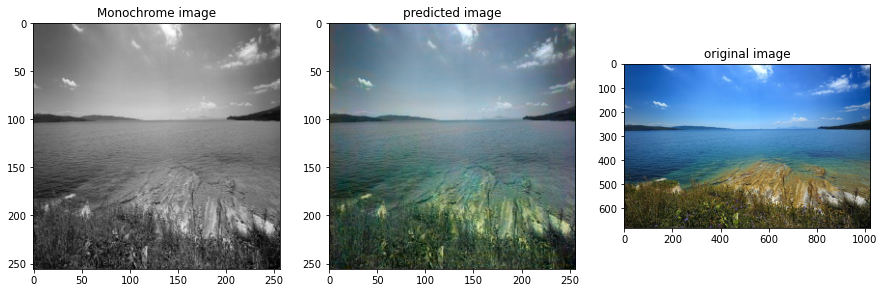

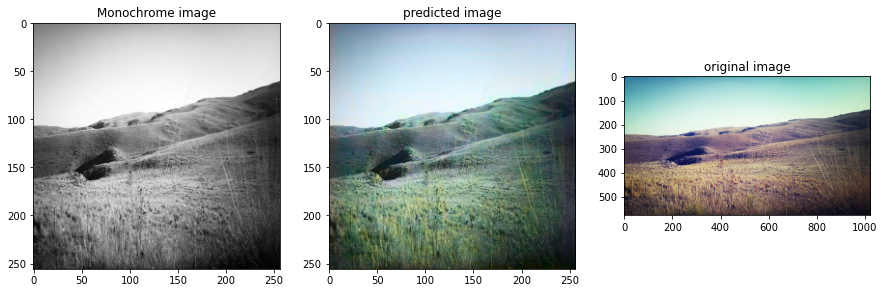

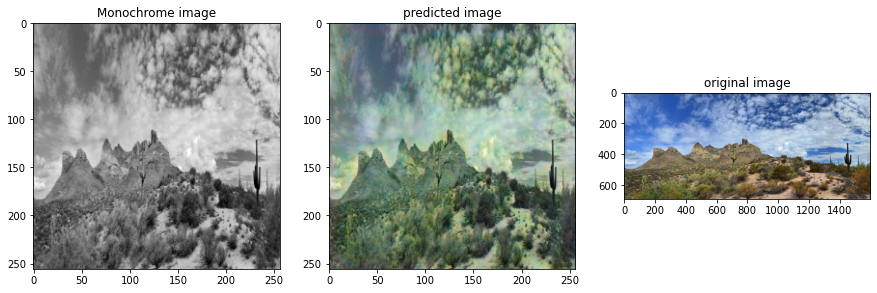

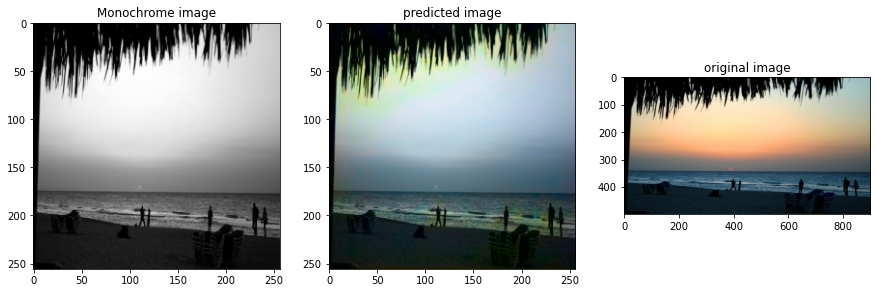

...

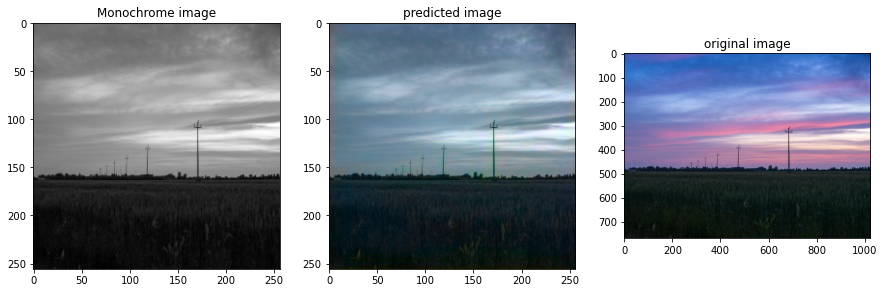

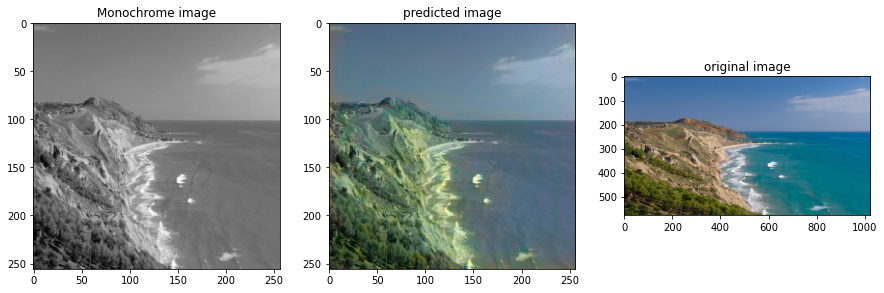

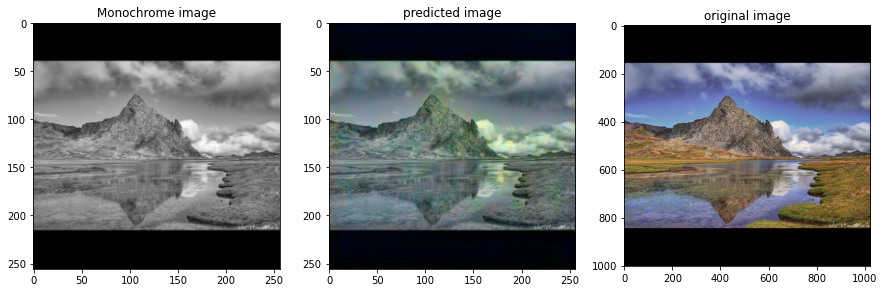

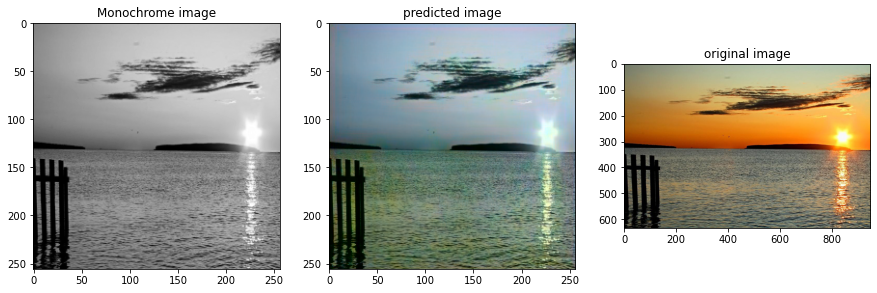

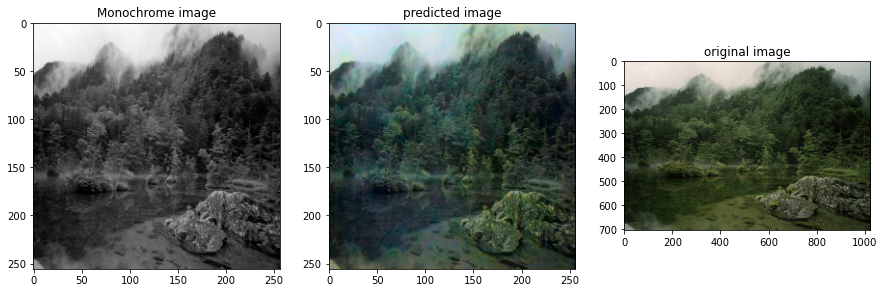

In [29]:
test = os.listdir(testpath)
for name in test:
    pred(name,generator)

# Defining Discriminator

In [12]:
def downsample(filters, size, apply_batchnorm=True):
    initializer = tf.random_normal_initializer(0., 0.02)
    result = tf.keras.Sequential()
    result.add(
      tf.keras.layers.Conv2D(filters, size, strides=2, padding='same',
                             kernel_initializer=initializer, use_bias=False))

    if apply_batchnorm:
        result.add(tf.keras.layers.BatchNormalization())

    result.add(tf.keras.layers.LeakyReLU())

    return result

In [13]:
def Discriminator():
    inp = layers.Input(shape=[img_size, img_size, 1], name='input')
    tar = layers.Input(shape=[img_size, img_size, OUTPUT_CHANNELS], name='target')
    x = layers.Concatenate()([tar, inp])
    down1 = downsample(64, 4, False)(x) 
    down2 = downsample(128, 4)(down1) 
    down3 = downsample(img_size, 4)(down2)
    zero_pad1 = layers.ZeroPadding2D()(down3) 
    conv = layers.Conv2D(512, 4, strides=1)(zero_pad1)
    leaky_relu = layers.LeakyReLU()(conv)
    zero_pad2 = layers.ZeroPadding2D()(leaky_relu)
    last = layers.Conv2D(1, 4, strides=1)(zero_pad2) 
    return tf.keras.Model(inputs=[inp, tar], outputs=last)
discriminator = Discriminator()

In [14]:
discriminator.summary()

Model: "model_3"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
target (InputLayer)             [(None, 256, 256, 2) 0                                            
__________________________________________________________________________________________________
input (InputLayer)              [(None, 256, 256, 1) 0                                            
__________________________________________________________________________________________________
concatenate_1 (Concatenate)     (None, 256, 256, 3)  0           target[0][0]                     
                                                                 input[0][0]                      
__________________________________________________________________________________________________
sequential (Sequential)         (None, 128, 128, 64) 3072        concatenate_1[0][0]        

In [15]:
test_imgs = []
img = img_to_array(load_img(testpath + '00000036_(5).jpg'))
img = resize(img ,(img_size,img_size))
test_imgs.append(img)
test_imgs = np.array(test_imgs, dtype=float)
test_img = rgb2lab(1.0/255*test_imgs)[:,:,:,0]
test_img = test_img.reshape(test_img.shape+(1,))
gen_out=generator.predict(test_img)

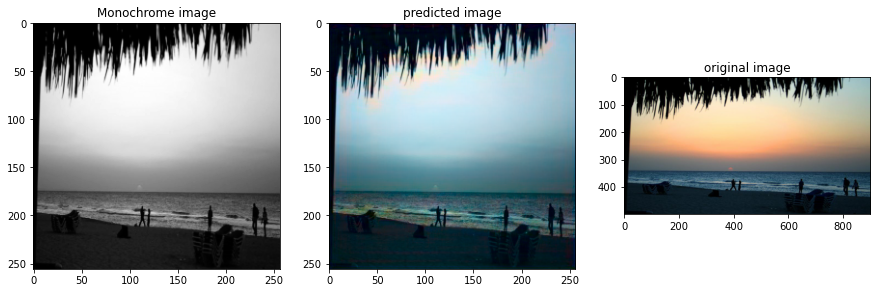

In [16]:
pred('00000036_(5).jpg',generator)

In [17]:
test_img.shape

(1, 256, 256, 1)

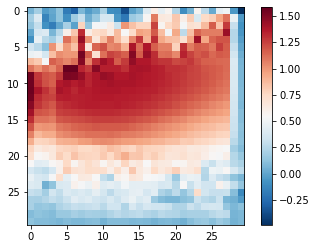

In [18]:
disc_out = discriminator([test_img, gen_out], training=False)
plt.imshow(disc_out[0, ..., -1], cmap='RdBu_r')
plt.colorbar()

# Defining Conditional GAN

In [19]:
class CGan(tf.keras.Model):
    def __init__(
                self,
                generator,
                discriminator,
                ):
        super(CGan, self).__init__()
        self.gen = generator
        self.disc = discriminator
        
    def compile(
                self,
                gen_optimizer,
                disc_optimizer,
                gen_loss_fn,
                disc_loss_fn,
                ):
        super(CGan, self).compile()
        self.gen_optimizer = gen_optimizer
        self.disc_optimizer = disc_optimizer
        self.gen_loss_fn = gen_loss_fn
        self.disc_loss_fn = disc_loss_fn
        
    def train_step(self, batch_data):
        input_image, target = batch_data
        with tf.GradientTape() as gen_tape, tf.GradientTape() as disc_tape:

            gen_output = self.gen(input_image, training=True)

            # discriminator used to check, inputing real images
            disc_real_output = self.disc([input_image, target], training=True)
            # discriminator used to check, inputing fake images
            disc_generated_output = self.disc([input_image, gen_output], training=True)

            # evaluates generator loss
            gen_total_loss, gen_gan_loss, gen_l1_loss = self.gen_loss_fn(disc_generated_output, gen_output, target)
            # evaluates discriminator loss
            disc_loss = self.disc_loss_fn(disc_real_output, disc_generated_output)

        # Calculate the gradients for generator and discriminator
        generator_gradients = gen_tape.gradient(gen_total_loss,
                                              self.gen.trainable_variables)

        discriminator_gradients = disc_tape.gradient(disc_loss,
                                                   self.disc.trainable_variables)

        # Apply the gradients to the optimizer
        
        generator_optimizer.apply_gradients(zip(generator_gradients,
                                              self.gen.trainable_variables))

        discriminator_optimizer.apply_gradients(zip(discriminator_gradients,
                                                  self.disc.trainable_variables))
        return {
                'gen_total_loss': gen_total_loss,
                'gen_gan_loss': gen_gan_loss,
                'gen_l1_loss': gen_l1_loss,
                'disc_loss': disc_loss
                }
    

In [20]:
loss_object = tf.keras.losses.BinaryCrossentropy(from_logits=True, reduction=tf.keras.losses.Reduction.SUM)
def discriminator_loss(disc_real_output, disc_generated_output):
    real_loss = loss_object(tf.ones_like(disc_real_output), disc_real_output)
    generated_loss = loss_object(tf.zeros_like(disc_generated_output), disc_generated_output)
    total_disc_loss = real_loss + generated_loss
    return total_disc_loss

In [21]:
LAMBDA = 100000
loss_object = tf.keras.losses.BinaryCrossentropy(from_logits=True, reduction=tf.keras.losses.Reduction.SUM)
def generator_loss(disc_generated_output, gen_output, target):
    gan_loss = loss_object(tf.ones_like(disc_generated_output), disc_generated_output)
    # Mean absolute error
    l1_loss = tf.reduce_mean(tf.abs(target - gen_output))
    total_gen_loss = gan_loss + (LAMBDA * l1_loss)

    return total_gen_loss, gan_loss, l1_loss

In [22]:
generator_optimizer = tf.keras.optimizers.Adam(2e-4, beta_1=0.5)
discriminator_optimizer = tf.keras.optimizers.Adam(2e-4, beta_1=0.5)

In [23]:
cgan_model = CGan(generator, discriminator)
cgan_model.compile(
        gen_optimizer = generator_optimizer,
        disc_optimizer = discriminator_optimizer,
        gen_loss_fn = generator_loss,
        disc_loss_fn = discriminator_loss)

In [24]:
cgan_model.fit(X,Y,epochs=5,batch_size=4)

Epoch 1/5
415/415 [==============================] - 132s 305ms/step - gen_total_loss: 4841.9523 - gen_gan_loss: 2524.7095 - gen_l1_loss: 0.0232 - disc_loss: 5027.2155
Epoch 2/5
415/415 [==============================] - 125s 300ms/step - gen_total_loss: 4607.3338 - gen_gan_loss: 2661.1710 - gen_l1_loss: 0.0195 - disc_loss: 5327.9571
Epoch 3/5
415/415 [==============================] - 126s 303ms/step - gen_total_loss: 4275.5105 - gen_gan_loss: 2494.6338 - gen_l1_loss: 0.0178 - disc_loss: 4989.3422
Epoch 4/5
415/415 [==============================] - 127s 306ms/step - gen_total_loss: 4209.3475 - gen_gan_loss: 2494.1343 - gen_l1_loss: 0.0172 - disc_loss: 4987.8615
Epoch 5/5
415/415 [==============================] - 127s 307ms/step - gen_total_loss: 4146.7751 - gen_gan_loss: 2494.0903 - gen_l1_loss: 0.0165 - disc_loss: 4987.8338


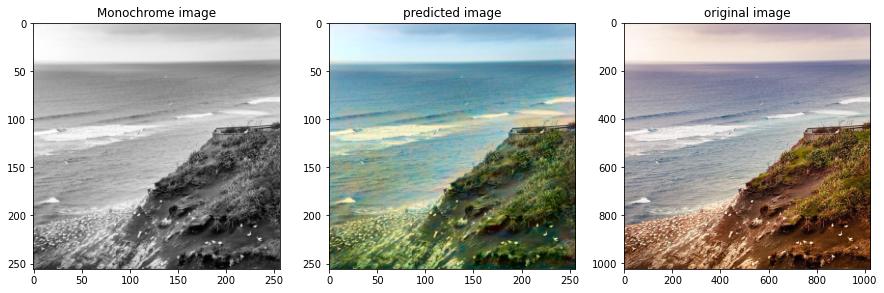

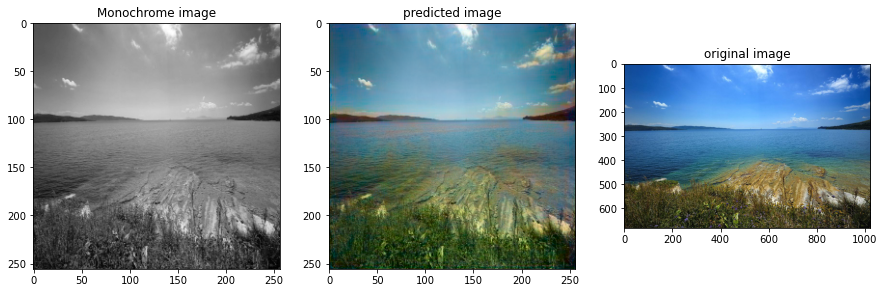

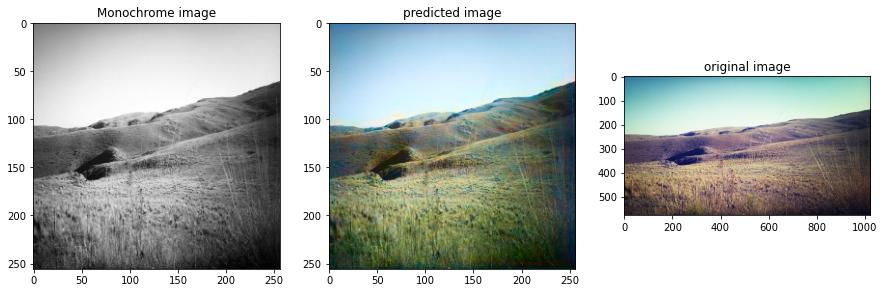

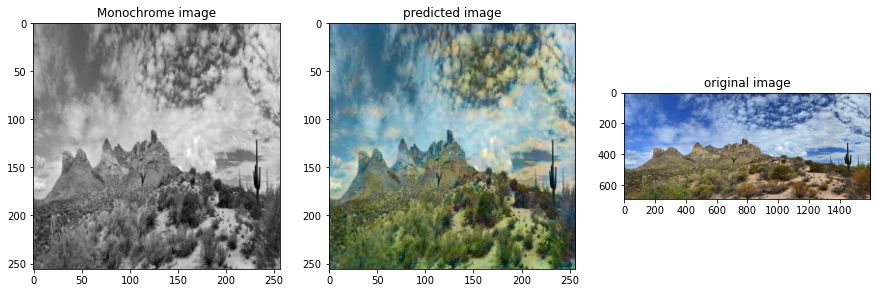

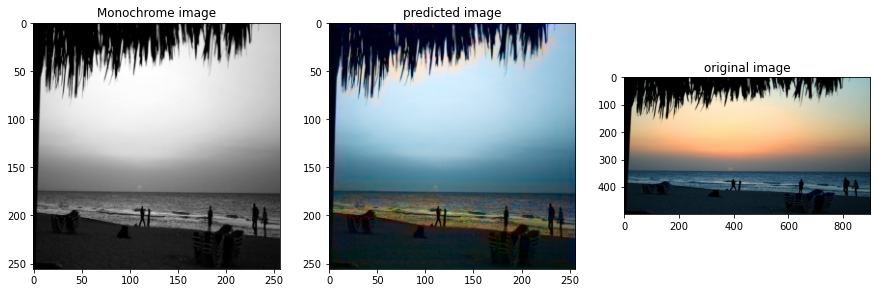

C:\Users\Chethan\anaconda3\lib\site-packages\skimage\color\colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 2 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


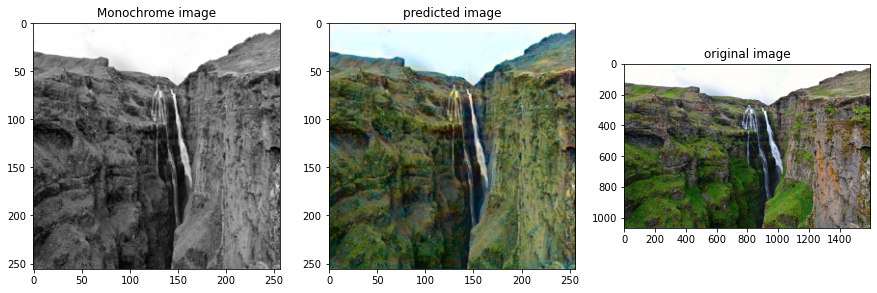

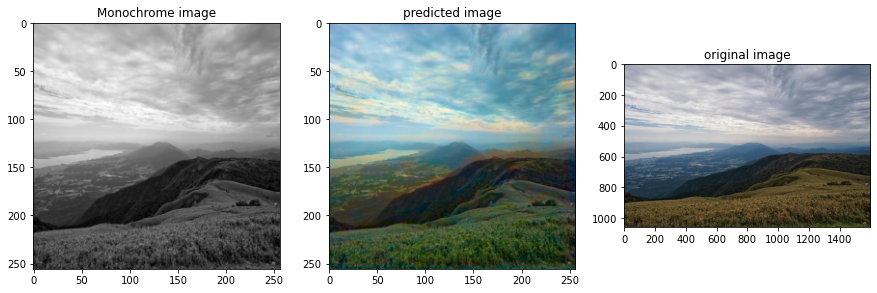

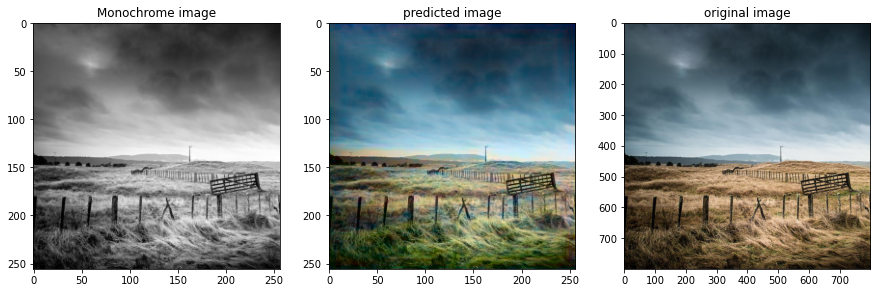

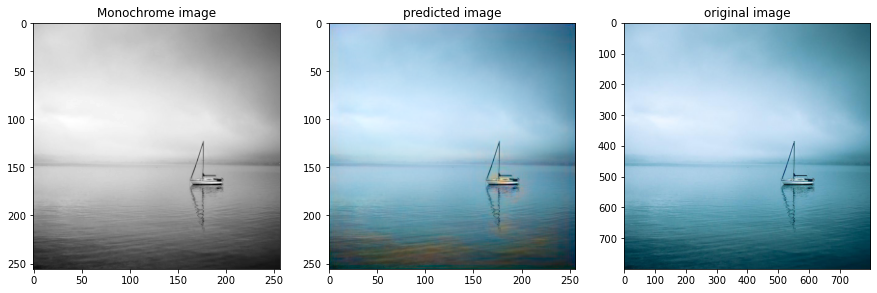

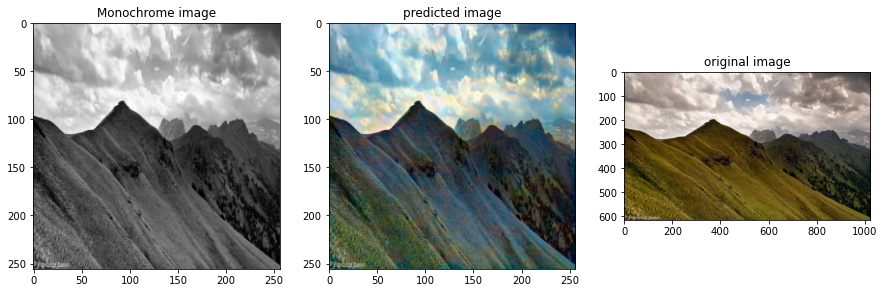

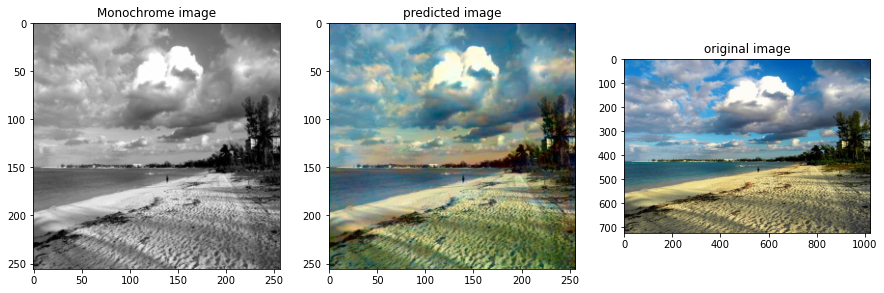

C:\Users\Chethan\anaconda3\lib\site-packages\skimage\color\colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 1 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


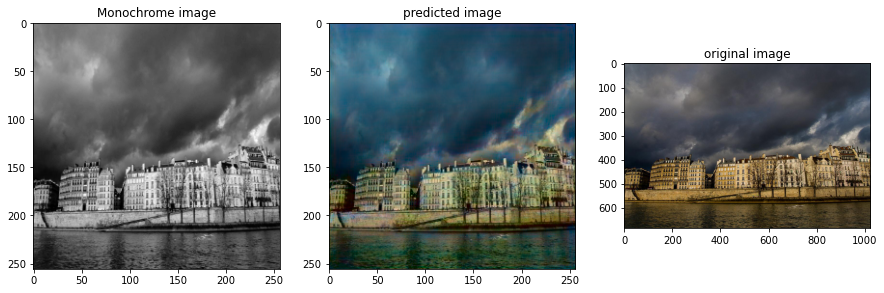

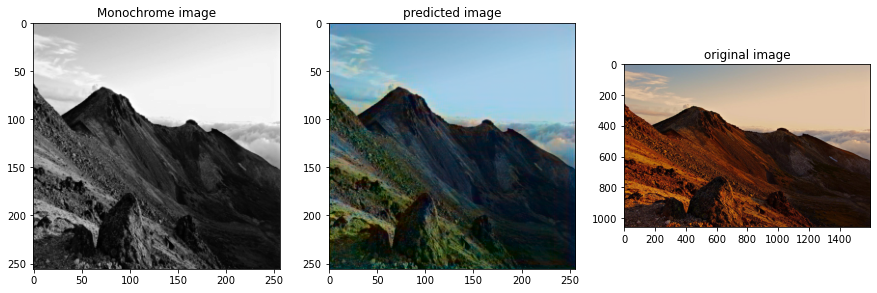

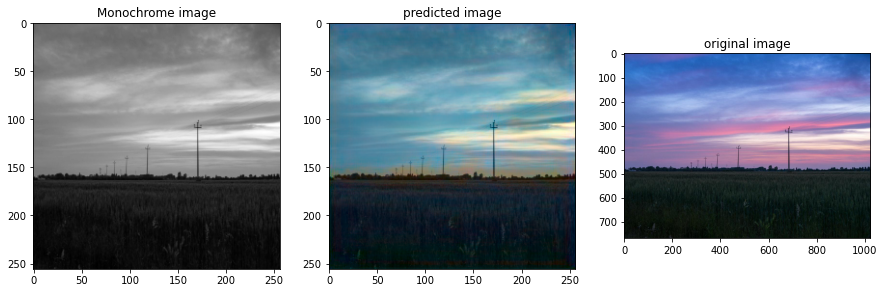

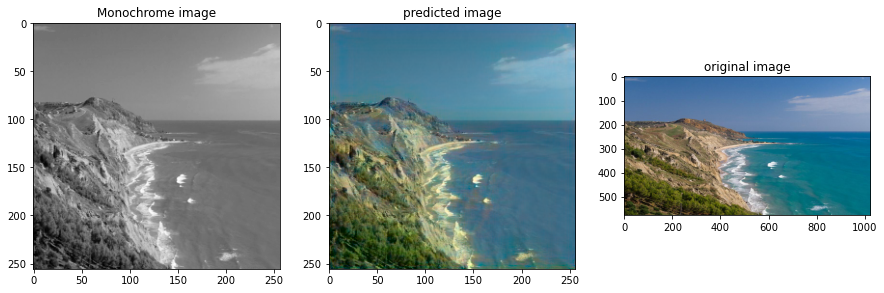

C:\Users\Chethan\anaconda3\lib\site-packages\skimage\color\colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 5 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


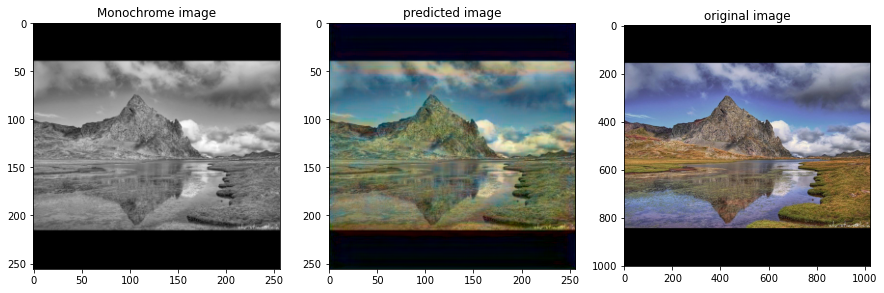

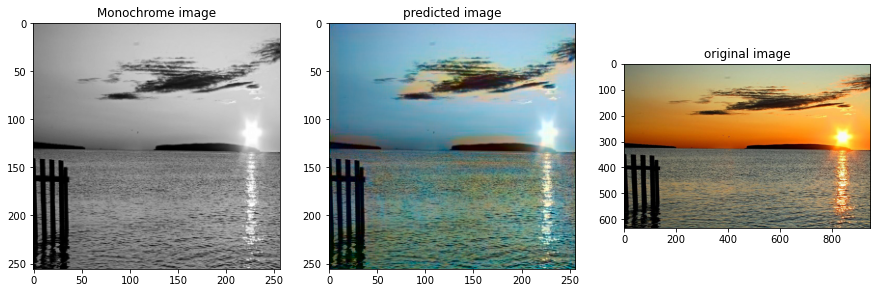

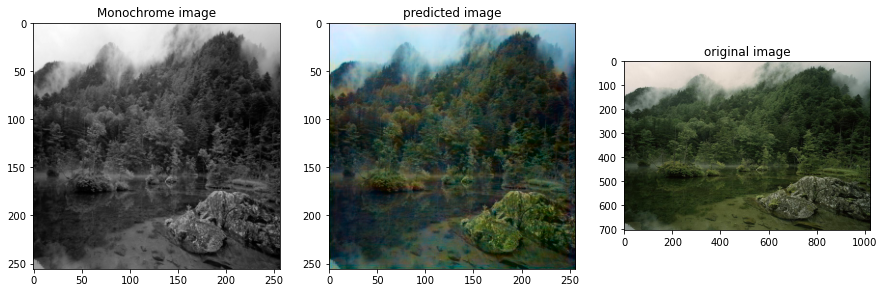

In [25]:
test = os.listdir(testpath)
for name in test:
    pred(name,cgan_model.gen)

In [26]:
def met(modelb):
    mse=[]
    for imgname in test:
        img = img_to_array(load_img(testpath + imgname))
        img = resize(img ,(img_size,img_size))
        test_imgs = []
        test_imgs.append(img)
        test_imgs = np.array(test_imgs, dtype=float)
        test_img = rgb2lab(1.0/255*test_imgs)[:,:,:,0]
        y_img=rgb2lab(1.0/255*test_imgs)[:,:,:,1:]/128
        test_img = test_img.reshape(test_img.shape+(1,))
        output1 = modelb.predict(test_img)
        output1 = output1 * 128
        for i in range(len(output1)):
            result = np.zeros((img_size,img_size, 3))
            result[:,:,0] = test_img[i][:,:,0]
            result[:,:,1:] = output1[i]
        mse.append(mean_squared_error(y_img[0],result[:,:,1:]))
    return np.mean(mse)
def pred1new(path,modelg):
    fig, axis = plt.subplots(1,2,figsize=(15,5))
    test_imgs = []
    img = img_to_array(load_img(testnewpath + path))
    img = resize(img ,(img_size,img_size))
    test_imgs.append(img)
    test_imgs = np.array(test_imgs, dtype=float)
    test_img = rgb2lab(1.0/255*test_imgs)[:,:,:,0]
    test_img = test_img.reshape(test_img.shape+(1,))
    axis[0].imshow(test_img[0],cmap='gray')           #showing monochrome image (input)
    axis[0].title.set_text("Monochrome image")
    output = modelg(test_img)
    output = output * 128
    for i in range(len(output)):
        result = np.zeros((img_size,img_size, 3))
        result[:,:,0] = test_img[i][:,:,0]
        result[:,:,1:] = output[i]
    axis[1].imshow(lab2rgb(result))                   #showing predicted image (output)
    axis[1].title.set_text("predicted image")    
    plt.show()

In [27]:
met(cgan_model.gen)

164.9331815448538

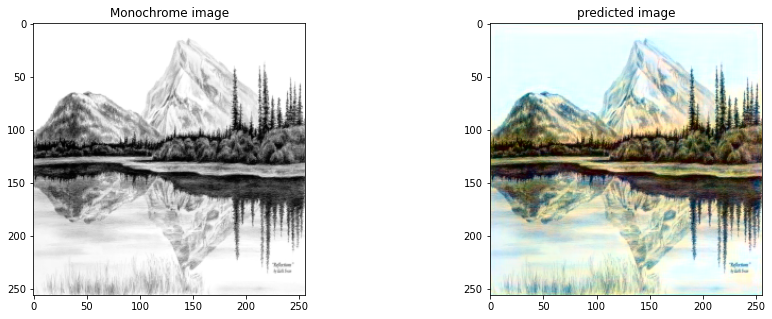

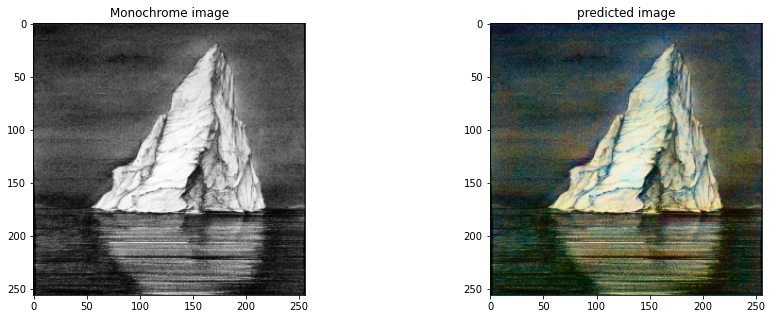

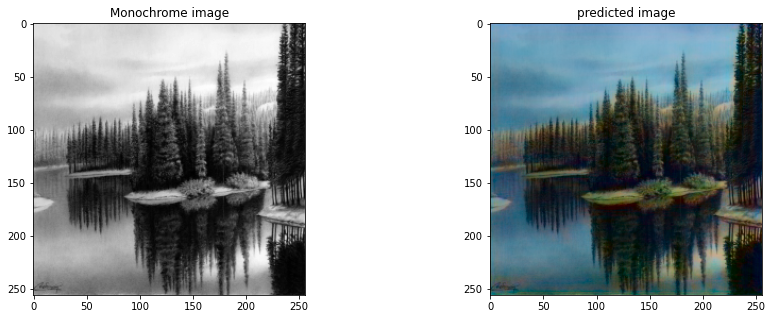

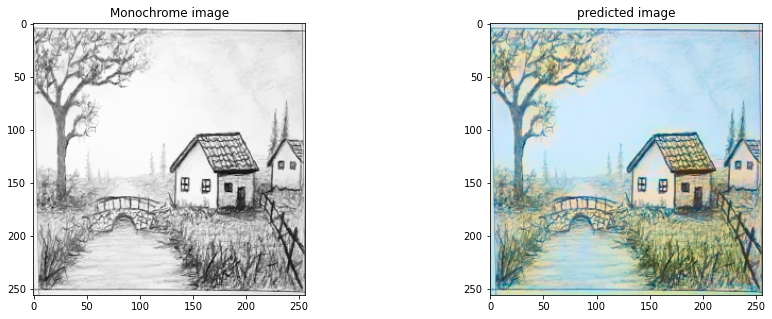

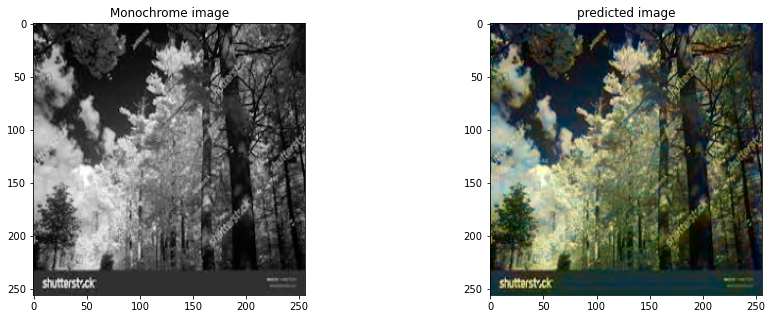

C:\Users\Chethan\anaconda3\lib\site-packages\skimage\color\colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 30 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


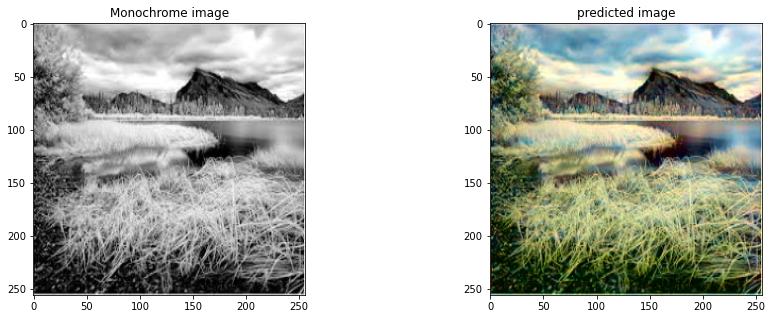

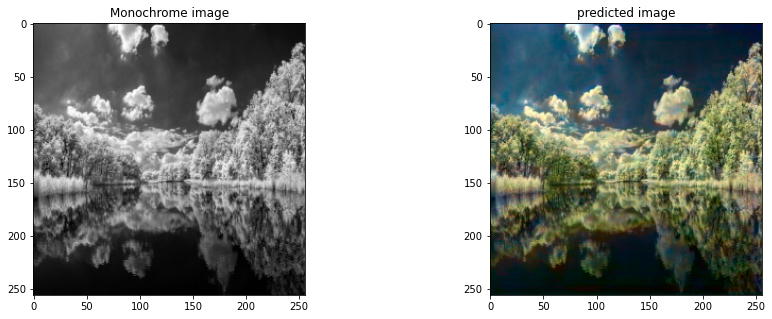

C:\Users\Chethan\anaconda3\lib\site-packages\skimage\color\colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 3 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


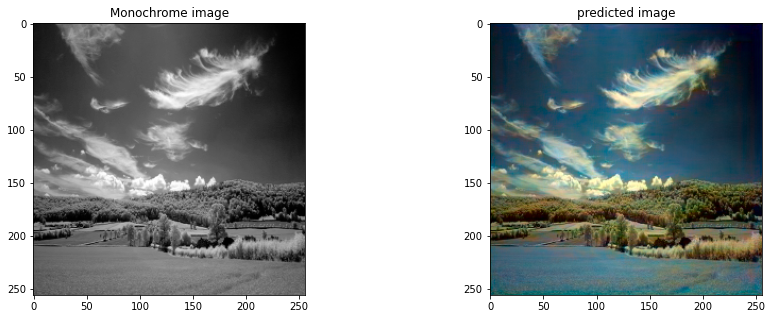

C:\Users\Chethan\anaconda3\lib\site-packages\skimage\color\colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 6 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


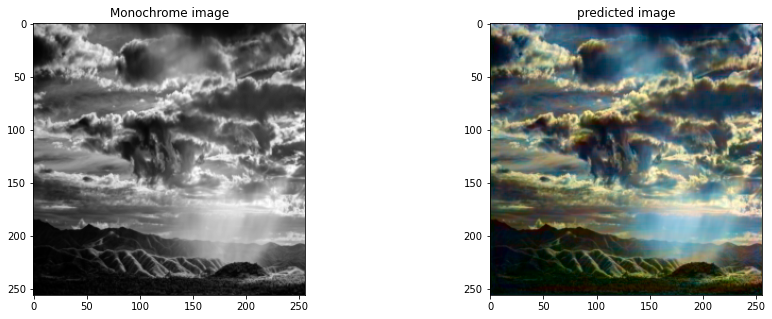

In [28]:
for name in testnew:
    pred1new(name,cgan_model.gen)

In [29]:
generator.save('unetgan-dsgood1.h5')

# Thank you